# Q-Learning (20分)
同学们好，在这个notebook中，你将学会如何使用Q-Learning算法来完成一个简单的电脑游戏，本Notebook包含的如下：
1. [**Q-Learning算法回顾**](#1.Q-Learning算法回顾)
2. [**准备工作**](#2.准备工作)
    * 安装依赖库
    * 导入依赖库
3. [**Taxi-v3**](#3.Taxi-v3🚖)
    * 熟悉Taxi-v3环境
    * 实现Q-learning算法
**注意：这个notebook中不涉及深度学习训练，大家可以不使用GPU加速器！** 
<div style="text-align:center;">
    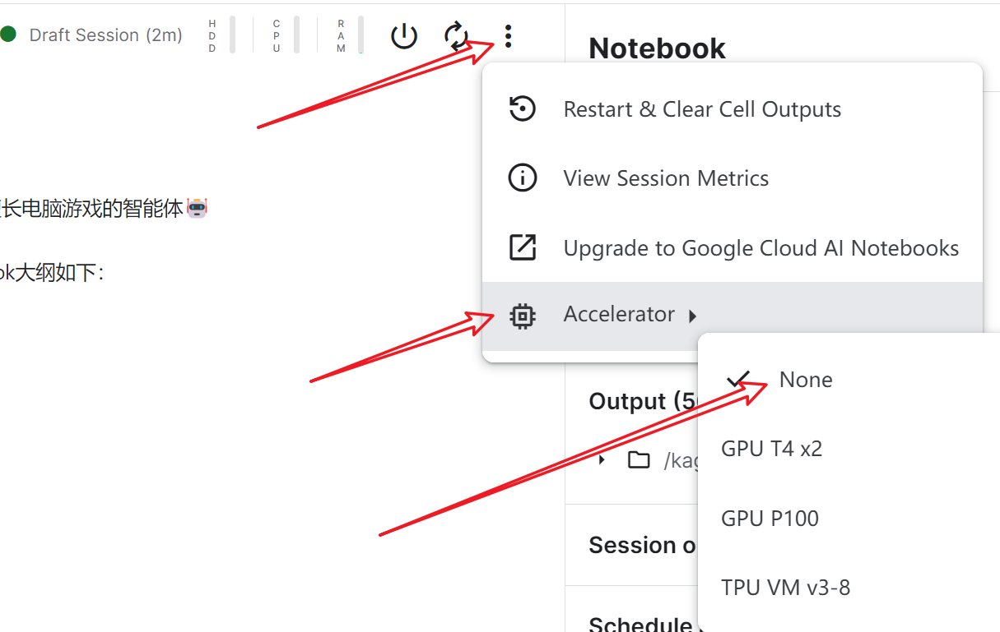
</div>

# 1.Q-Learning算法回顾
Q-Learning算法的伪代码如下：
 - 第一步：初始化Qtable(一般全都初始化为0)
 - 第二步：根据ε-greedy策略选择动作A
 - 第三步：执行动作A,观察奖励R和新的状态S'
 - 第四步：更新Qtable: $Q(S,A)_{new}=Q(S,A)_{old}+\alpha[R+\gamma\text{max}_{a'}Q(S',a')_{old}-Q(S,A)_{old}]$
 
<div style="text-align:center;">
    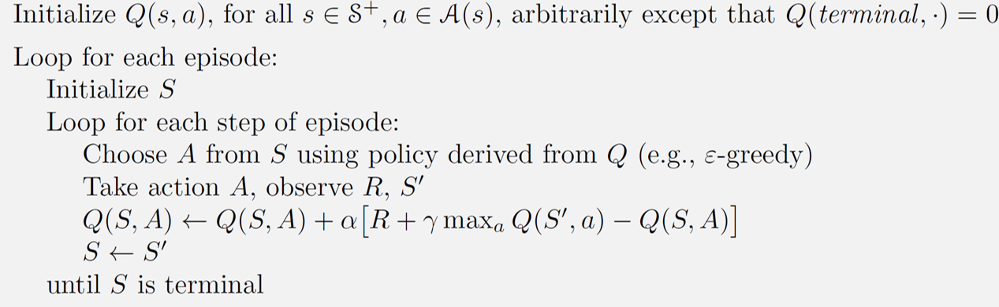
</div>

需要注意的是Q-Learning是一种off-policy算法，即执行策略（ε-greedy）和更新策略（greedy）不同

# 2.准备工作
## 2.1 安装依赖库
请先运行下面代码安装本次实验需要用到的库函数和工具函数，**第一次安装的时候可能会需要一段时间**，请耐心等待运行结束后再往后执行 \
其中`> /dev/null 2>&1`是为了折叠输出，不然这一部分会输出很大一块中间结果，影响notebook阅读

In [1]:
!pip install -r /kaggle/input/hw4-rl/q-learning-requirements.txt > /dev/null 2>&1
!sudo apt-get update > /dev/null 2>&1
!sudo apt-get install -y python3-opengl > /dev/null 2>&1
!apt install ffmpeg xvfb > /dev/null 2>&1

## 2.2 导入依赖库
请运行下面代码块导入需要使用到的库，其中`random`用来生成随机数字(在实现epsilon-greedy策略中会用到)； `imageio`会被用来生成一个游戏视频；`gymnasium`为我们提供游戏环境

In [2]:
import numpy as np
import torch
import gymnasium as gym
import random
import os
import tqdm
from tqdm.notebook import tqdm

import sys
sys.path.append('/kaggle/input/hw4-rl/')
from test_qlearning import *

# 3.Taxi-v3🚖
该部分一共包含以下内容：
- 熟悉Taxi-v3环境
- 实现Q-Learning算法

## 3.1 熟悉Taxi-v3环境
<div style="text-align:center;">
    <img src="https://gymnasium.farama.org/_images/taxi.gif" alt="FrozenLake" style="display:inline-block; height:300px; width:auto;">
</div>

### **游戏目标**
Taxi是一个经典的强化学习环境，其游戏环境如上图所示。我们的目标是使用Q-Learning算法训练一个智能体，这个智能体能够引导出租车从起始位置出发，首先运行到乘客位置接上乘客，然后载着乘客到达目的地。

具体来说：在5x5的网格世界中，有四个指定的乘客上车和下车位置（红色、绿色、黄色和蓝色）。出租车从一个随机方格开始，乘客位于其中一个指定的位置。
目标是将出租车移动到乘客所在位置，接上乘客，然后将乘客送到目的地，最后让乘客下车。一旦乘客下车，该回合就结束了。

首先请运行下面的代码创建环境：

In [3]:
# 创建 frozen lake环境
env = gym.make("Taxi-v3", render_mode="rgb_array")

### **动作空间**
Taxi-v3中一共包含6种动作（用0到5这四个数字来标识）：
* 0: 向南移动（向下）
* 1: 向北移动（向上）
* 2: 向东移动（向右）
* 3: 向西移动（向左）
* 4: 接乘客
* 5: 放下乘客

下面我们输出环境中的动作进一步查看：\
其中`env.action_space.n`会返回环境中的动作空间大小； `env.action_space.sample()`会随机采样一个动作

In [4]:
print("-----Frozen Lake 动作空间-----")
print("动作空间大小：", env.action_space.n)
print("随机采样一个动作：", env.action_space.sample())

-----Frozen Lake 动作空间-----
动作空间大小： 6
随机采样一个动作： 3


### **状态空间**
Taxi-v3中有500个离散状态，因为有25个出租车位置，乘客可能在的5个位置（包括乘客在出租车内的情况），以及4个目的地位置

乘客有5种可能的位置：
* 0: 红色
* 1: 绿色
* 2: 黄色
* 3: 蓝色
* 4: 在出租车内

目的地有4种可能的位置：
* 0: 红色
* 1: 绿色
* 2: 黄色
* 3: 蓝色

下面我们输出环境中的状态进一步查看： \
其中`env.observation_space.n`会返回环境中的状态空间大小； `env.observation_space.sample()`会随机采样一个状态

In [5]:
print("-----Frozen Lake 动作空间-----")
print("状态空间大小：", env.observation_space.n)
print("随机采样一个状态：", env.observation_space.sample())

-----Frozen Lake 动作空间-----
状态空间大小： 500
随机采样一个状态： 24


### **奖励函数**
玩家成功将乘客送到正确位置会获得正面奖励。尝试错误地接送乘客以及每个没有获得其他奖励的操作都会受到负面奖励，具体奖励函数如下：
- +20： 成功将乘客送到目的地
- -10： 在不该上下车的位置执行上下车操作
- -1： 除了上述两种情形外，每次操作都会得到-1奖励

### **终止条件**
当遇到以下两种情况时，游戏回合结束：
- terminated: 成功将乘客送到目的地
- truncated: 移动超过步数（如200步），依旧没有将乘客送到目的地

### **官方文档**
同学们可以查看Taxi-v3的官方文档以了解更多细节：[链接](https://gymnasium.farama.org/environments/toy_text/taxi/)

## 3.2 实现Q-Learning算法
### **第一步：创建并初始化Q-table**
我们首先需要创建Q-table，其**行数等于状态数**，**列数等于动作数**；第 i 行第 j 列的值$Q(s_i, a_j)$表示在状态$s_i$时执行动作$a_j$能够得到的折扣回报的期望，初始时Q-table中的所有值都为0\
提示：回顾lab1中讲过的pytorch中的tensor创建
#### **代码填空1**：Q-table初始化 (2分)

In [6]:
def initialize_qtable(state_num: int, action_num: int) -> torch.Tensor:
    """
    初始化q-table，其行数=state_num，列数=action_num；并初始化所有值为0
    Args:
        state_num(int): 状态数
        action_num(int): 动作数
    Return:
        qtable(torch.Tensor): 初始的全0的Q-table
    """
    # TODO: 初始化qtable, 是一个state_num行，action_num列的全0的torch.Tensor
    qtable = torch.zeros(state_num, action_num)
    return qtable

#### **测试代码1**：Q-table初始化

In [7]:
test_qtable_initialize(initialize_qtable)

-----Q-table初始化正确！√-----


### 第二步：定义策略
Q-learing算法是一个**off-policy**的算法，一共包含两个策略，其中一个用来执行(称作执行策略)，另一个用来计算TD-target(称作更新策略)

- 执行策略是一个Epsilon-greedy策略
- 更新策略是一个Greedy策略

#### **Greedy策略**
Greedy策略的定义为$a=\max_a Q(S, a)$，即在状态$S$下选出能够带来最大价值的动作$a$，请完成下面的`greedy_policy`函数，并通过后续的测试代码
#### **代码填空2**：定义Greedy策略 (3分)
提示: [torch.argmax](https://pytorch.org/docs/stable/generated/torch.argmax.html)

In [8]:
def greedy_policy(Qtable: torch.Tensor, state: int) -> int:
    """
    Args:
        Qtable(torch.Tensor): 当前的Q-table, 是一个形状为(num_state, num_action)的二维数组
        state(int): 当前的状态
    Return：
        action(int): 状态state下价值最高的动作
    """
    # TODO: 在Qtable中查询状态state对应的所有动作中价值最高的动作，并返回该动作
    # 不能使用任何形式的循环，请使用pytorch中的函数
    action = torch.argmax(Qtable[state])

    return action

#### **测试代码2：**greedy策略

In [9]:
test_greedy_policy(greedy_policy)

-----Greedy策略测试通过！√-----


#### ε-Greedy策略

ε-Greedy是对探索(exploring)和利用(exploitation)的权衡，它的定义如下： 

- 以 *1 - ɛ* 的概率: 进行**利用(exploitation)** (按照greedy策略选择给定状态下价值最高的动作).

- 以 *ɛ* 的概率: 进行**探索(exploration)** (随机选择一个动作).

#### **代码填空3**: 定义ε-Greedy策略 (5分)

In [10]:
def epsilon_greedy_policy(Qtable:torch.Tensor, state:int,
                          epsilon:float, random_num:float=None) -> int:
    """
    按照ε-greedy策略返回状态state下对应的动作：
    首先生成一个处于0-1之间的随机数：
        * 如果随机数大于ε，按照greedy策略返回动作；
        * 如果随机数小于等于ε，从动作空间中随机返回一个动作
    Args:
        Qtable(torch.Tensor): 当前的Q-table,包含num_state行，num_action列
        state(int): 当前所处的状态
        epsilon(float): 值位于0-1之间的浮点数，用于权衡探索和利用
        random_num(float): 默认值为None，一般不会从外部传参而是在函数内生成，仅测试用例时需要从外部传入（同学们不用管）
    Return:
        action(int): 选择出的动作
    """
    if random_num is None:
        # TODO: 生成一个0到1之间的随机数
        random_num = random.uniform(0,1)
    assert 0 <= random_num <=1, "测试未通过，随机数必须在0-1之间！"
        
    # if random_num > epsilon --> 利用(exploitation)
    if random_num > epsilon:
        # TODO: 给定一个状态，按照greedy策略选择具有最高价值的动作
        # 提示：torch.argmax()
        action = torch.argmax(Qtable[state])
    # else --> 探索(exploration)
    else:
        # TODO: 从动作空间中随机选择一个动作
        action = random.randint(0,Qtable.size(1)-1)
    
    return action

#### **测试代码3**：ε-greedy策略

In [11]:
test_epsilon_greedy_policy(epsilon_greedy_policy)

-----if random_num > epsilon --> 利用(exploitation)部分测试通过！√-----
-----else --> 探索(exploration)部分测试通过！√-----
-----恭喜你，该部分测试通过！-----


### 第三步：设置超参数
首先需要设置Q-learning算法中的超参数 (为了减轻工作量，已经设好了，直接运行即可)
- `n_training_episodes`: 训练的总回合数
- `max_steps`: 每个回合的最大交互步数（建议设置在99-199之间）
- `learning_rate`: 学习率（建议设置在0-1之间）
- `gamma`: 折扣回报中的奖励衰减系数（0-1之间）
- `max_epsilon`: 最大的ε（即初始值，0-1之间）
- `min_epsilon`: 最小的ε（0至max_epsilon之间）
- `decay_rate`: ε的衰减速率（0-1之间）

In [12]:
# 训练参数
n_training_episodes = 10_000 # Total training episodes
max_steps = 99               # Max steps per episode
learning_rate = 0.7          # Learning rate
gamma = 0.95                 # Discounting rate

# 探索和利用权衡
max_epsilon = 1           # Exploration probability at start
min_epsilon = 0.05        # Minimum exploration probability
decay_rate = 0.005        # Exponential decay rate for exploration prob

### 第四步：实现Q-learning并训练智能体
* Q-Learning中的更新公式为：$Q(s,a)_{new}=Q(s,a)_{old}+\alpha[R+\gamma\text{max}_{a'}Q(s',a')_{old}-Q(s,a)_{old}]$
* 其中$Q(s,a)_{old}$是更新前的价值，$Q(s,a)_{new}$是更新后的价值，$\alpha$是学习率，$\gamma$是折扣率
* $s,a$是当前的状态和当前步执行的动作；$s',a'$是新的状态和新状态下对应的动作
* 需要注意的是在计算TD-target时是按照greedy策略选择下一个状态$s'$时对应的动作$a'$
#### **代码填空4**: Qtable更新 (5分)

In [13]:
def update_qtable(Qtable: torch.Tensor, state: int, action: int, new_state: int,
                  lr: float, gamma: float, reward: int) -> torch.Tensor:
    """
    更新Qtable: Q(s,a)' = Q(s,a) + lr * [r + γ * max_a' Q(s', a') - Q(s,a)]
    Args:
        Qtable(torch.Tensor): 更新前的Qtable
        state(int): 当前的状态
        new_state(int): 下一个状态
        action(int): 当前执行的动作
        lr(float): 学习率
        gamma(float): 折扣系数
        reward(int): 该步交互得到的即时奖励
    """
    # TODO: 更新Qtable中的Q(s,a)这一项
    # 提示：Q(s,a)_new = Q(s,a)_old + lr * [r + γ * max_a' Q(s', a')_old - Q(s,a)_old]
    Qtable[state][action] = Qtable[state][action] + lr * (reward + gamma * torch.max(Qtable[new_state]) - Qtable[state][action])
    
    return Qtable

#### **测试代码4**: Qtable更新

In [14]:
test_update_qtable(update_qtable)

-----Qtable更新测试通过√-----
-----注意：此处测试结果仅供参考，若后续训练过程中算法不能收敛，请检查此处代码是否正确！-----


#### **执行训练**
请**不要修改**下面的代码，直接运行即可

In [15]:
# 初始化Qtable
state_num = env.observation_space.n
action_num = env.action_space.n
Qtable_taxi = initialize_qtable(state_num, action_num)

rewards_all_episode = []
steps_all_episode = []
# 逐回合训练
for episode in tqdm(range(n_training_episodes)):
    reward_current_episode = 0
    # 随着训练的进行，逐步减小epsilon（从探索转为利用）
    epsilon = min_epsilon + (max_epsilon - min_epsilon)*np.exp(-decay_rate*episode)
    # 每个回合都需要重新初始化游戏环境(返回初始状态s0)
    state, info = env.reset()
    step = 0
    terminated = False # 到达终点或掉入洞中为True，回合结束
    truncated = False # 达到最大步数时为True，回合结束

    # 同一回合中逐步
    for step in range(max_steps):
        # 根据ε-greedy策略选择在状态s时需要执行的动作a
        action = epsilon_greedy_policy(Qtable_taxi, state, epsilon)
        # 在状态s下执行动作At, 并观察到新的状态s'和即时奖励r
        new_state, reward, terminated, truncated, info = env.step(int(action))
        reward_current_episode += reward
        # 更新Q-table
        Qtable_taxi = update_qtable(Qtable_taxi,state,action,new_state,learning_rate,gamma,reward)
        # 判断回合是否中止
        if terminated or truncated:
            break
        # 从下一个状态开始重复上述步骤直至回合终止
        state = new_state
        
    rewards_all_episode.append(reward_current_episode)
    steps_all_episode.append(step)
    
    # 输出25次训练状态
    print_freq = n_training_episodes // 20
    if episode % print_freq == 0 or episode == n_training_episodes - 1:
        average_rewards = torch.mean(torch.tensor(rewards_all_episode[-print_freq:], dtype=torch.float64))
        average_steps = torch.mean(torch.tensor(steps_all_episode[-print_freq:], dtype=torch.float64))
        print(f'[{episode} / {n_training_episodes} ({episode/n_training_episodes*100:.2f}%)] current epsilon: {epsilon:.5f} averaged rewards: {average_rewards:.4f} average steps: {average_steps:.2f}')

  0%|          | 0/10000 [00:00<?, ?it/s]

[0 / 10000 (0.00%)] current epsilon: 1.00000 averaged rewards: -360.0000 average steps: 98.00
[500 / 10000 (5.00%)] current epsilon: 0.12798 averaged rewards: -132.1460 average steps: 56.40
[1000 / 10000 (10.00%)] current epsilon: 0.05640 averaged rewards: 3.1700 average steps: 13.99
[1500 / 10000 (15.00%)] current epsilon: 0.05053 averaged rewards: 4.5280 average steps: 13.37
[2000 / 10000 (20.00%)] current epsilon: 0.05004 averaged rewards: 4.8240 average steps: 13.16
[2500 / 10000 (25.00%)] current epsilon: 0.05000 averaged rewards: 5.4100 average steps: 12.77
[3000 / 10000 (30.00%)] current epsilon: 0.05000 averaged rewards: 5.1900 average steps: 12.96
[3500 / 10000 (35.00%)] current epsilon: 0.05000 averaged rewards: 5.5980 average steps: 12.84
[4000 / 10000 (40.00%)] current epsilon: 0.05000 averaged rewards: 5.4480 average steps: 12.79
[4500 / 10000 (45.00%)] current epsilon: 0.05000 averaged rewards: 5.3900 average steps: 12.79
[5000 / 10000 (50.00%)] current epsilon: 0.05000 a

#### **保存训练好的Qtable**
请**不要修改**下面的代码，直接运行即可(**后续被抽到的同学需要提交此文件，请大家记得下载保存！**）

In [16]:
torch.save(Qtable_taxi, './qtable_taxi.pth')

### 第五步：测试智能体 (5分)
在训练好智能体后，我们运行20个回合，每个回合最大交互步数为20步。每个回合如果在规定步数内将乘客送达目的地则认为该回合游戏成功。超过80%的回合（>=16个回合）通过测试可以得到该部分的5分。

请直接运行下面测试代码即可：

-----通过测试的回合共：20个-----
第1回合，是否到达终点：True


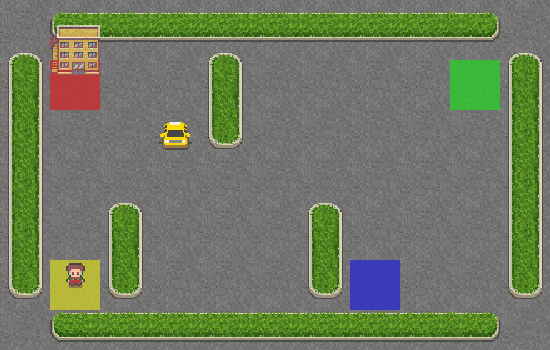

第4回合，是否到达终点：True


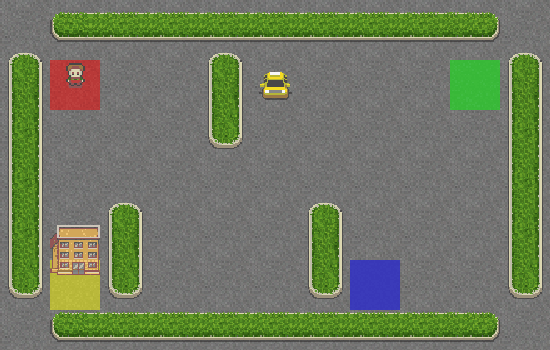

第5回合，是否到达终点：True


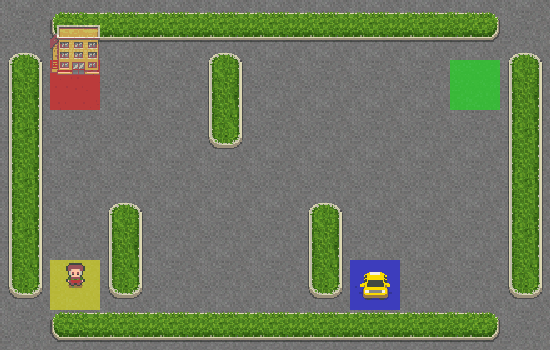

第6回合，是否到达终点：True


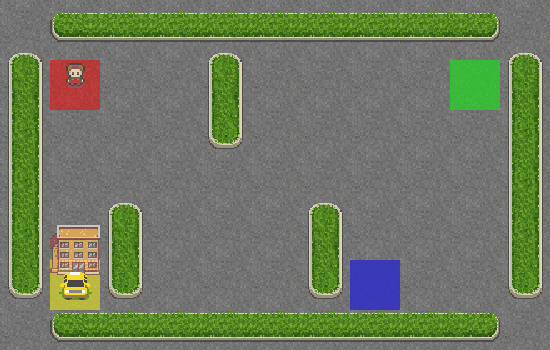

第7回合，是否到达终点：True


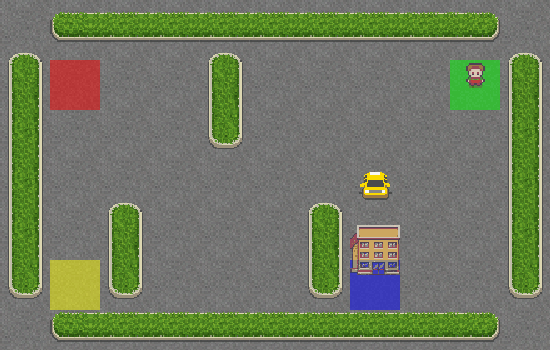

第8回合，是否到达终点：True


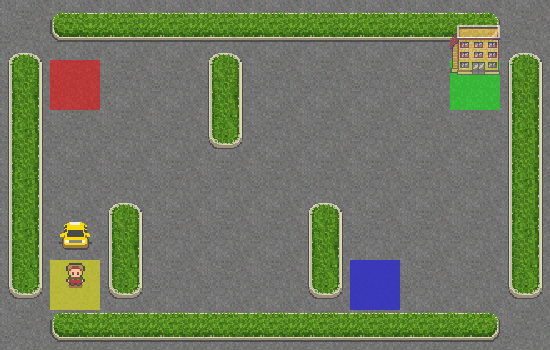

第9回合，是否到达终点：True


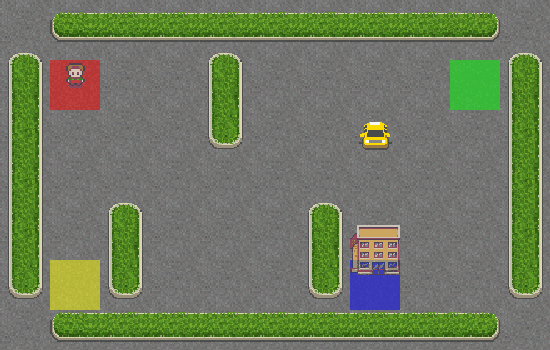

第10回合，是否到达终点：True


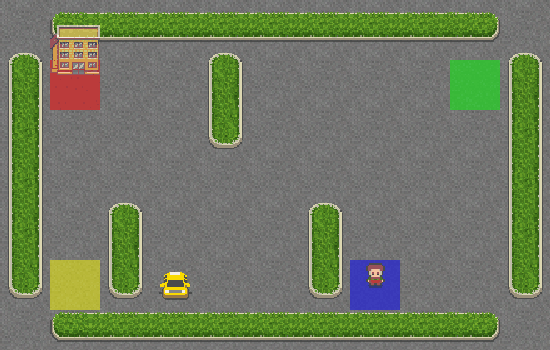

第11回合，是否到达终点：True


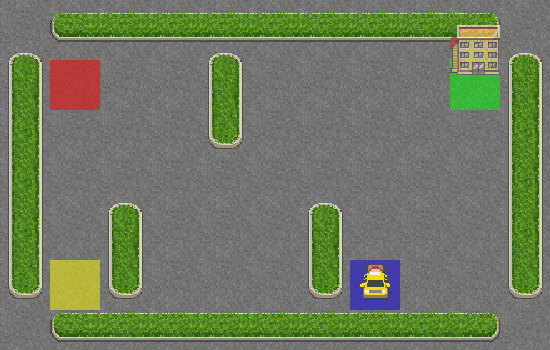

第12回合，是否到达终点：True


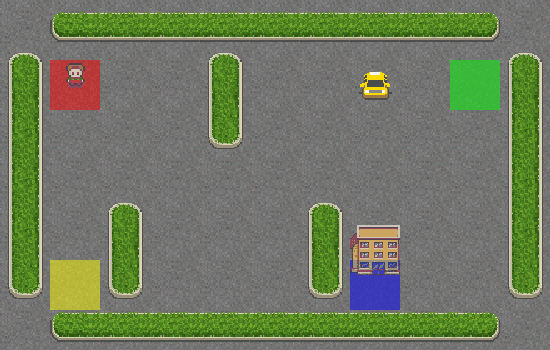

第13回合，是否到达终点：True


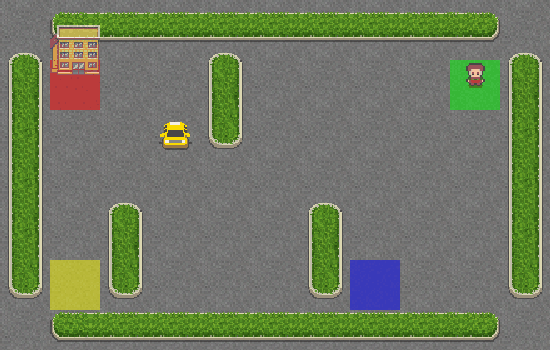

第14回合，是否到达终点：True


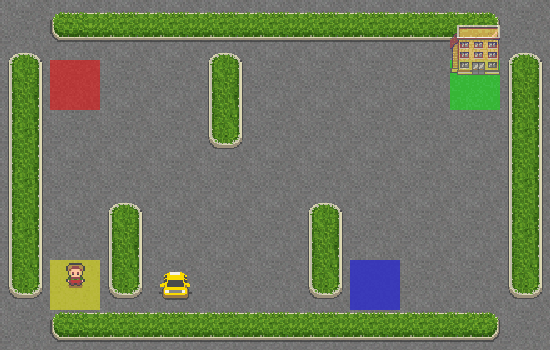

第15回合，是否到达终点：True


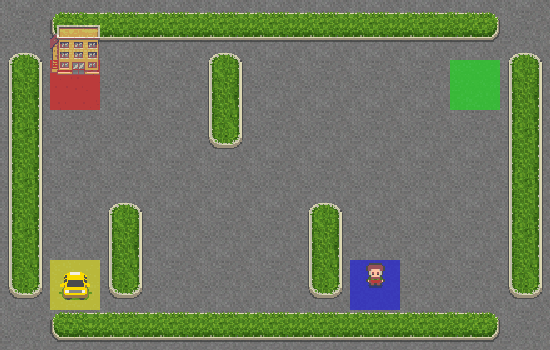

第16回合，是否到达终点：True


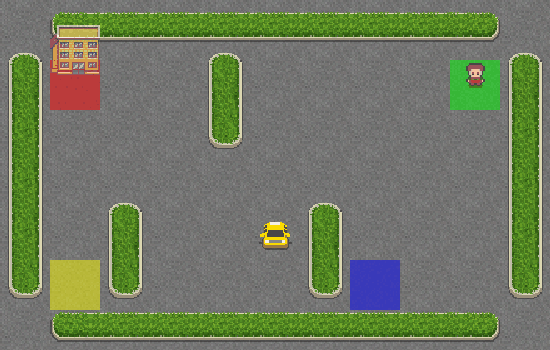

第17回合，是否到达终点：True


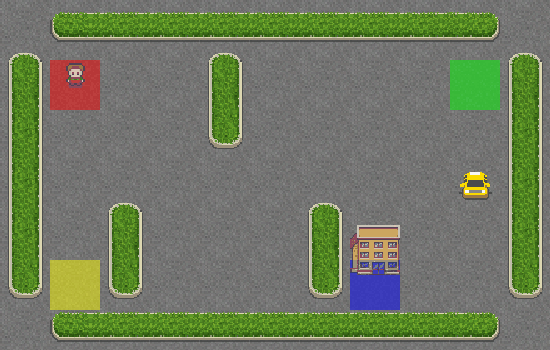

第18回合，是否到达终点：True


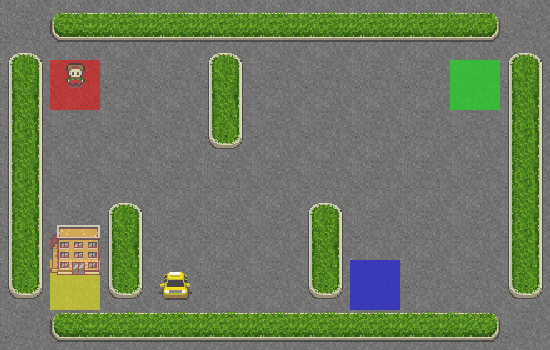

第19回合，是否到达终点：True


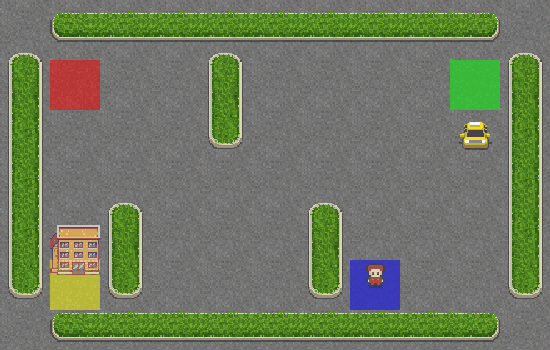

第20回合，是否到达终点：True


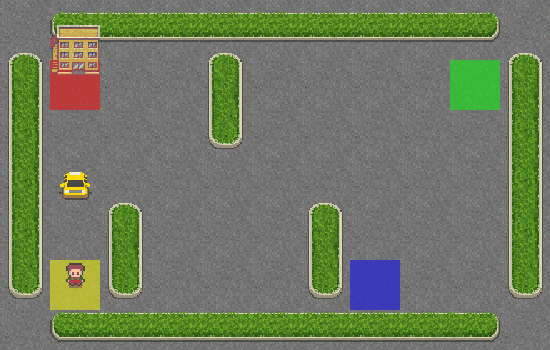

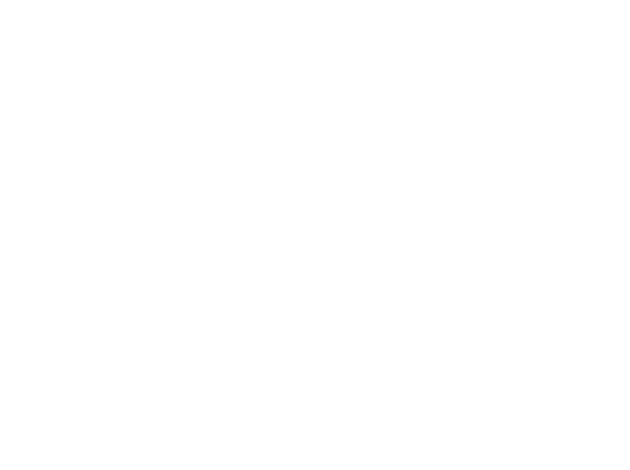

In [17]:
test_q_learning(Qtable_taxi, greedy_policy)